In [1]:
%load_ext autoreload
%autoreload 2
import tqdm, tqdm.notebook
tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path
import numpy as np

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_exhaustive, pairs_from_minseong, pairs_from_retrieval
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

# Setup

In [2]:
images = Path('datasets/etri12-ex/')
outputs = Path('outputs/etri12-ex-retrieval/')
# !rm -rf $outputs
sfm_pairs = outputs / 'pairs-sfm.txt'
loc_pairs = outputs / 'pairs-loc.txt'
sfm_pairs_re = outputs / 'pairs-sfm-retrieval.txt'
sfm_dir = outputs / 'sfm'
local_features = outputs / 'local_features.h5'
global_features = outputs / 'global_features.h5'
local_features_q = outputs / 'local_features_q.h5'
global_features_q = outputs / 'global_features_q.h5'
matches = outputs / 'matches.h5'
loc_matches = outputs / 'loc_matches.h5'

feature_conf = extract_features.confs['disk']
g_feature_conf = extract_features.confs['cosplace']
matcher_conf = match_features.confs['disk+lightglue']

# 3D mapping

172 mapping images


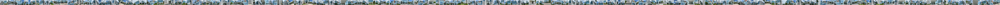

In [3]:
references = [p.relative_to(images).as_posix() for p in (images / 'mapping/').iterdir()]
print(len(references), "mapping images")
plot_images([read_image(images / r) for r in references], dpi=25)

In [4]:
# extract_features.main(feature_conf, images, image_list=references, feature_path=local_features)

In [5]:
# extract_features.main(image_dir=images, conf=g_feature_conf, image_list=references, feature_path=global_features)

In [6]:
# pairs_from_exhaustive.main(sfm_pairs, image_list=references)
# pairs_from_minseong.main(output=sfm_pairs, image_list=references)
# pairs_from_retrieval.main(descriptors=global_features, output=sfm_pairs_re, num_matched=20)

In [7]:
# match_features.main(matcher_conf, sfm_pairs_re, features=local_features, matches=matches);

In [9]:
model = reconstruction.main(sfm_dir, images, sfm_pairs_re, local_features, matches, image_list=references)
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

[2023/08/24 16:23:32 hloc WARNING] The database already exists, deleting it.
[2023/08/24 16:23:32 hloc INFO] Creating an empty database...
[2023/08/24 16:23:32 hloc INFO] Importing images into the database...
[2023/08/24 16:23:33 hloc INFO] Importing features into the database...


  0%|          | 0/172 [00:00<?, ?it/s]

[2023/08/24 16:23:34 hloc INFO] Importing matches into the database...


  0%|          | 0/3440 [00:00<?, ?it/s]

[2023/08/24 16:23:36 hloc INFO] Performing geometric verification of the matches...
[2023/08/24 16:23:40 hloc INFO] Running 3D reconstruction...
W0824 16:24:31.017098 1537382 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0824 16:24:31.063165 1537382 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0824 16:24:31.185756 1537382 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0824 16:24:31.453641 1537382 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0824 16:24:31.501587 1537382 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable t

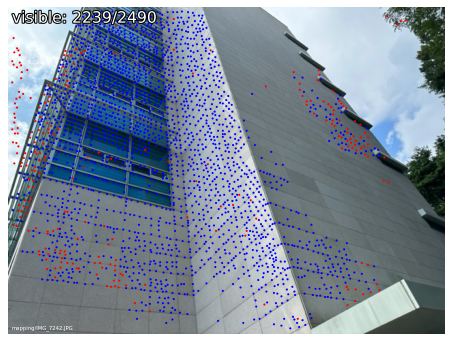

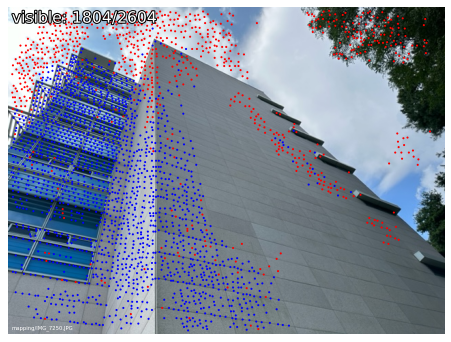

In [10]:
visualization.visualize_sfm_2d(model, images, color_by='visibility', n=2)

# Localization

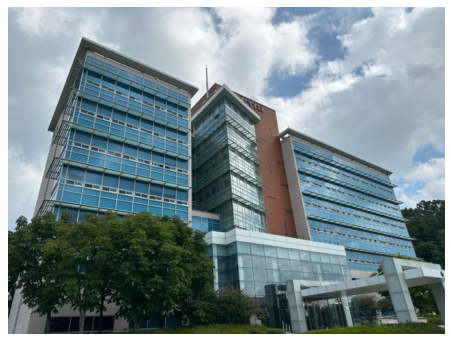

In [11]:
query = 'query/IMG_6864.JPG'
plot_images([read_image(images / query)], dpi=75)

In [12]:
extract_features.main(feature_conf, images, image_list=[query], feature_path=local_features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references)
match_features.main(matcher_conf, loc_pairs, features=local_features, matches=matches, overwrite=True);

[2023/08/24 16:54:25 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2023/08/24 16:54:27 hloc INFO] Finished exporting features.
[2023/08/24 16:54:27 hloc INFO] Found 172 pairs.
[2023/08/24 16:54:27 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/172 [00:00<?, ?it/s]

[2023/08/24 16:54:35 hloc INFO] Finished exporting matches.


found 8205/14016 inlier correspondences.


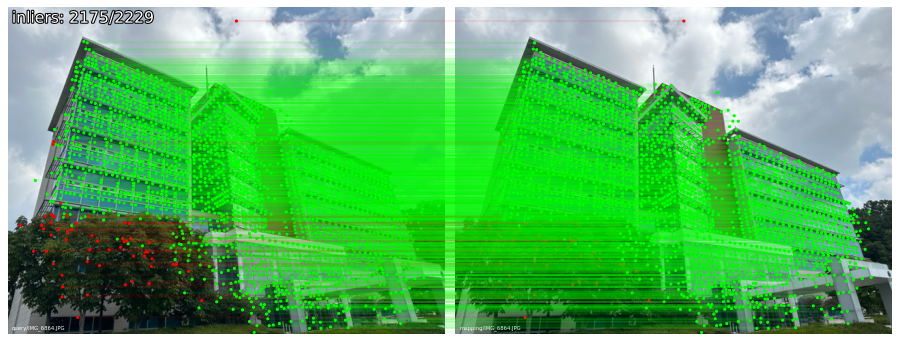

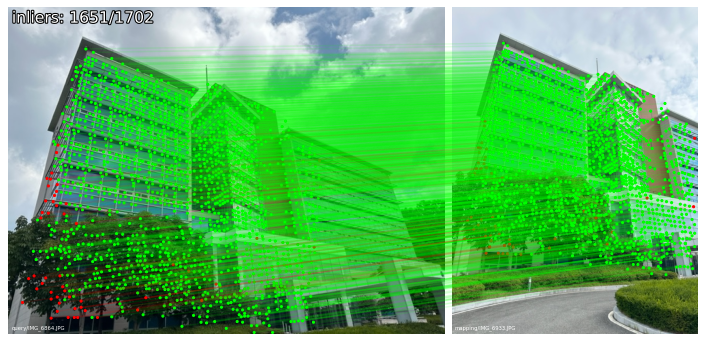

In [22]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
# ref_ids = [model.find_image_with_name(r).image_id for r in references]
ref_ids = []
for reference in references:
    # print(model.find_image_with_name(reference).image_id)
    # print(reference)
    # print(model.find_image_with_name(reference))
    if model.find_image_with_name(reference) == None:
        continue
    else:
        ref_ids.append(model.find_image_with_name(reference).image_id)

conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, local_features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

In [23]:
pose = pycolmap.Image(tvec=ret['tvec'], qvec=ret['qvec'])
viz_3d.plot_camera_colmap(fig, pose, camera, color='rgba(0,255,0,0.5)', name=query, fill=True)
# visualize 2D-3D correspodences
inl_3d = np.array([model.points3D[pid].xyz for pid in np.array(log['points3D_ids'])[ret['inliers']]])
viz_3d.plot_points(fig, inl_3d, color="lime", ps=1, name=query)
fig.show()